                                       Betting churn prediction

In [21]:
import numpy as np
import pandas as pd
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import missingno as msno
import seaborn as sns
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, roc_auc_score, confusion_matrix
from sklearn.ensemble import GradientBoostingClassifier
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import RobustScaler



Loading the dataset

In [3]:
data = pd.read_csv('data.csv') 

In [8]:
data.head()

,player_key,birth_year,date,gaming_turnover_sum,gaming_turnover_num,gaming_NGR,betting_turnover_sum,betting_turnover_num,betting_NGR,deposit_sum,deposit_num,withdrawal_sum,withdrawal_num,login_num
0,4046512869593056000,1998,2021-10-29,0.0,0,0.0,0.0,0,0,0,0,0,0,1
1,4046512869593056000,1998,2021-07-18,0.0,0,0.0,0.0,0,0,0,0,0,0,1
2,4046512869593056000,1998,2021-08-04,0.0,0,0.0,0.0,0,0,0,0,0,0,1
3,4046512869593056000,1998,2021-07-30,0.0,0,0.0,0.0,0,0,0,0,0,0,1
4,4046512869593056000,1998,2021-08-23,0.0,0,0.0,0.0,0,0,0,0,0,0,1


The dataset contains 12,500 customers described by the following features:

* `player_key`: A unique customer identifier
* `birth_year`: The customer's birth year
* `date`: The date of the aggregated metrics below
* `gaming_turnover_sum`: The sum of bets placed on live casino and casino games
* `gaming_turnover_num`: The number of bets placed on live casino and casino
  games
* `gaming_NGR`: The net gaming revenue (NGR) from live casino and casino games
  (i.e., how much the individual lost)
* `betting_turnover_sum`: The sum of bets placed on sports betting
* `betting_turnover_num`: The number of bets placed on sports betting
* `betting_NGR`: The net gaming revenue (NGR) from sports betting (i.e., how
  much the individual lost)
* `deposit_sum`: The sum of deposits from the customer's bank account to their
  gambling account
* `deposit_num`: The number of deposits from the customer's bank account to
  their gambling account
* `withdrawal_sum`: The sum of withdrawals from the customer's gambling account
  to their bank account
* `withdrawal_num`: The number of withdrawals from the customer's gambling
  account to their bank account
* `login_num`: The number of logins made

In [9]:
data.shape

(417113, 14)

In [10]:
data.info

<bound method DataFrame.info of                  player_key  birth_year        date  gaming_turnover_sum  \
0       4046512869593056000        1998  2021-10-29                 0.00   
1       4046512869593056000        1998  2021-07-18                 0.00   
2       4046512869593056000        1998  2021-08-04                 0.00   
3       4046512869593056000        1998  2021-07-30                 0.00   
4       4046512869593056000        1998  2021-08-23                 0.00   
...                     ...         ...         ...                  ...   
417108 -1236372937558555703        2003  2023-05-03              1518.05   
417109  1398322063812768303        1990  2022-06-02              4910.73   
417110  4520549823660323401        1989  2022-10-27               900.07   
417111  4520549823660323401        1989  2022-09-28              1167.54   
417112 -3829449197151729304        1974  2022-10-20              3783.12   

        gaming_turnover_num  gaming_NGR  betting_turnov

In [11]:
data.columns.values

array(['player_key', 'birth_year', 'date', 'gaming_turnover_sum',
       'gaming_turnover_num', 'gaming_NGR', 'betting_turnover_sum',
       'betting_turnover_num', 'betting_NGR', 'deposit_sum',
       'deposit_num', 'withdrawal_sum', 'withdrawal_num', 'login_num'],
      dtype=object)

In [15]:
data.dtypes

player_key                int64
birth_year                int64
date                     object
gaming_turnover_sum     float64
gaming_turnover_num       int64
gaming_NGR              float64
betting_turnover_sum    float64
betting_turnover_num      int64
betting_NGR               int64
deposit_sum               int64
deposit_num               int64
withdrawal_sum            int64
withdrawal_num            int64
login_num                 int64
dtype: object

<Axes: >

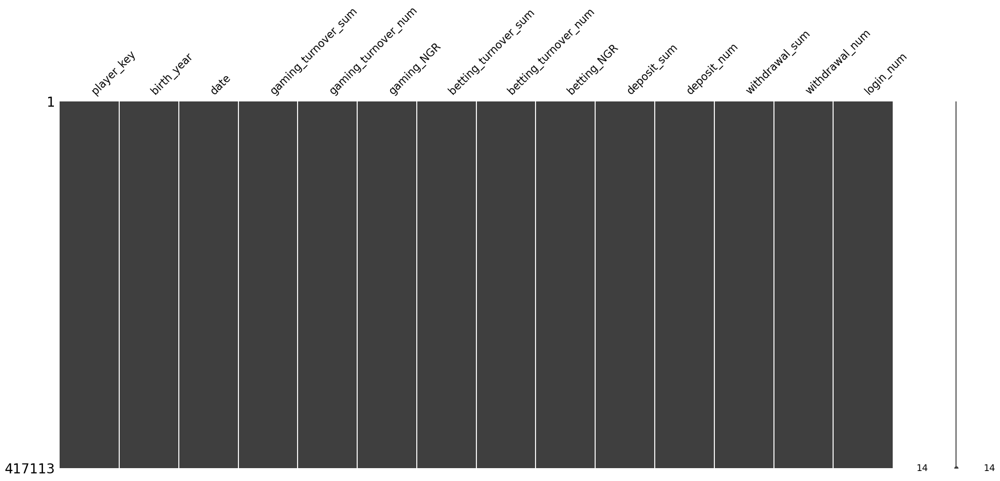

In [18]:
msno.matrix(data)

There are no missing values in the current dataset

Data Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 417113 entries, 0 to 417112
Data columns (total 14 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   player_key            417113 non-null  int64         
 1   birth_year            417113 non-null  int64         
 2   date                  417113 non-null  datetime64[ns]
 3   gaming_turnover_sum   417113 non-null  float64       
 4   gaming_turnover_num   417113 non-null  int64         
 5   gaming_NGR            417113 non-null  float64       
 6   betting_turnover_sum  417113 non-null  float64       
 7   betting_turnover_num  417113 non-null  int64         
 8   betting_NGR           417113 non-null  int64         
 9   deposit_sum           417113 non-null  int64         
 10  deposit_num           417113 non-null  int64         
 11  withdrawal_sum        417113 non-null  int64         
 12  withdrawal_num        417113 non-null  int64   

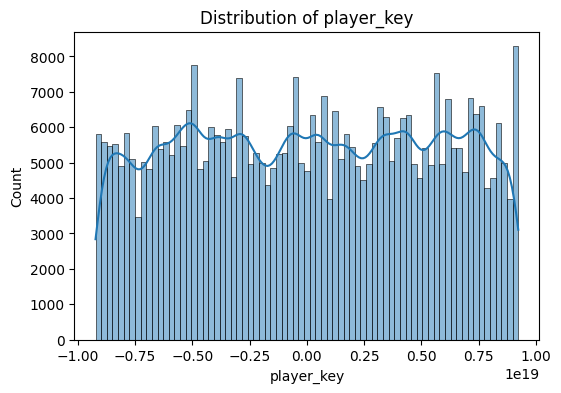

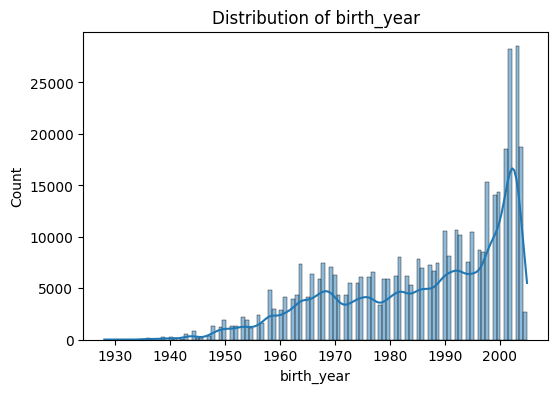

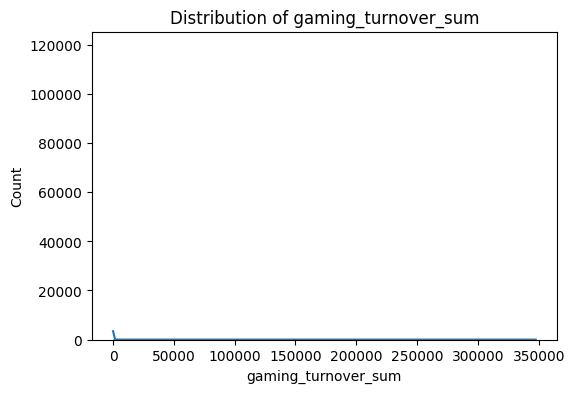

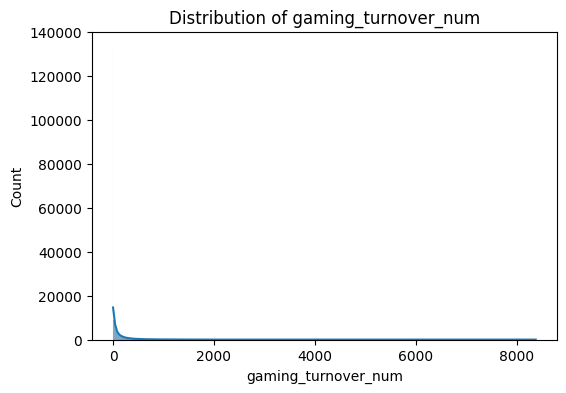

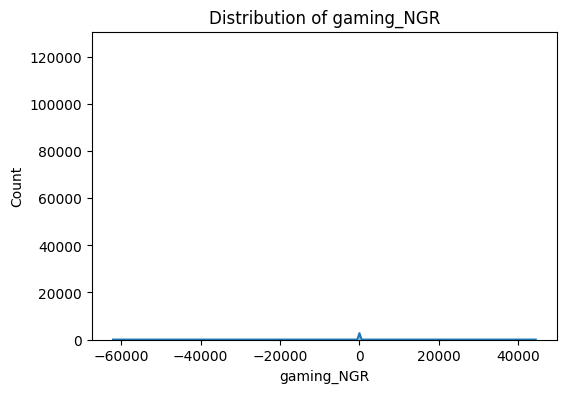

...

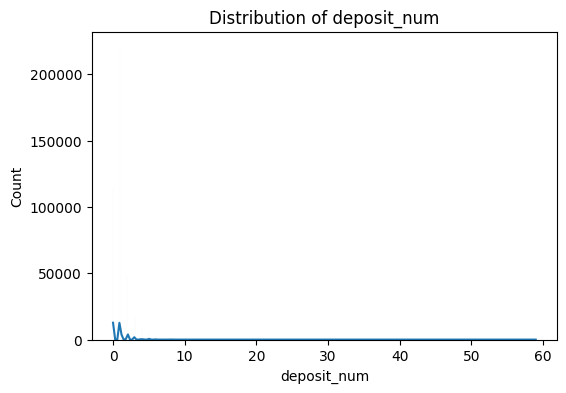

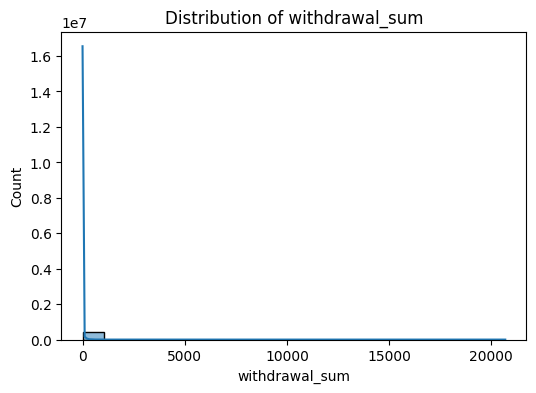

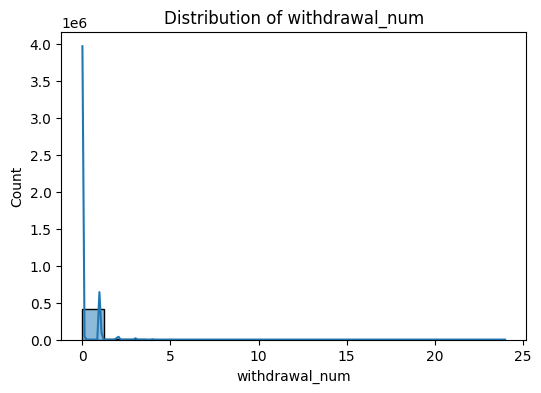

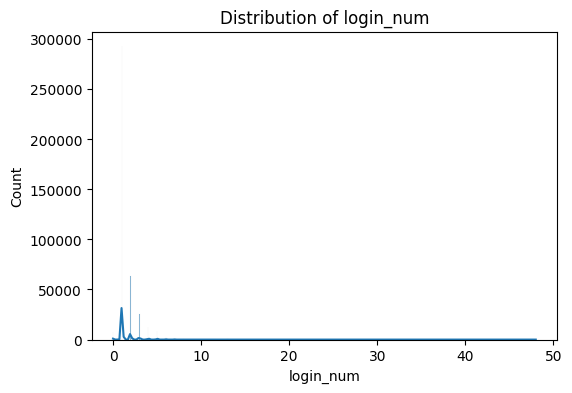

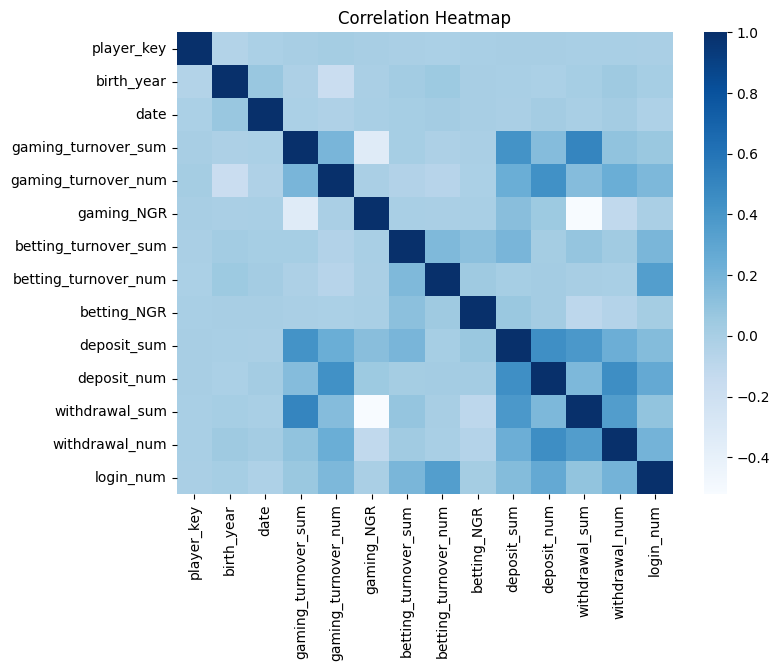

In [25]:
def run_eda(df):
    """
    Basic EDA steps: info, describe, missing values, distribution plots, correlation heatmap.
    """
    # Info and summary statistics
    print("Data Info:")
    df.info()
    print("\nSummary Statistics:")
    print(df.describe())

    # Missing values
    print("\nMissing Values:")
    print(df.isna().sum())

    # Distribution of numeric features
    numeric_cols = df.select_dtypes(include='number').columns
    for col in numeric_cols:
        plt.figure(figsize=(6,4))
        sns.histplot(data=df, x=col, kde=True)
        plt.title(f"Distribution of {col}")
        plt.show()

    # Correlation matrix
    plt.figure(figsize=(8,6))
    sns.heatmap(df.corr(), annot=False, cmap='Blues')
    plt.title("Correlation Heatmap")
    plt.show()
if __name__ == "__main__":
    data = pd.read_csv('data.csv')
    # Ensure 'date' is in datetime format
    data['date'] = pd.to_datetime(data['date'])
    run_eda(data)

Correlation Matrix (Pandas):
                       birth_year  gaming_turnover_sum  gaming_turnover_num  \
birth_year              1.000000            -0.016875            -0.166498   
gaming_turnover_sum    -0.016875             1.000000             0.190564   
gaming_turnover_num    -0.166498             0.190564             1.000000   
gaming_NGR             -0.005618            -0.331753            -0.006197   
betting_turnover_sum    0.030318             0.013152            -0.040566   
betting_turnover_num    0.053588            -0.016834            -0.069442   
betting_NGR             0.005757            -0.006416            -0.011714   
deposit_sum            -0.001630             0.419610             0.243525   
deposit_num            -0.014386             0.138554             0.430418   
withdrawal_sum          0.007226             0.505492             0.140507   
withdrawal_num          0.043604             0.097643             0.244661   
login_num               0.008223  

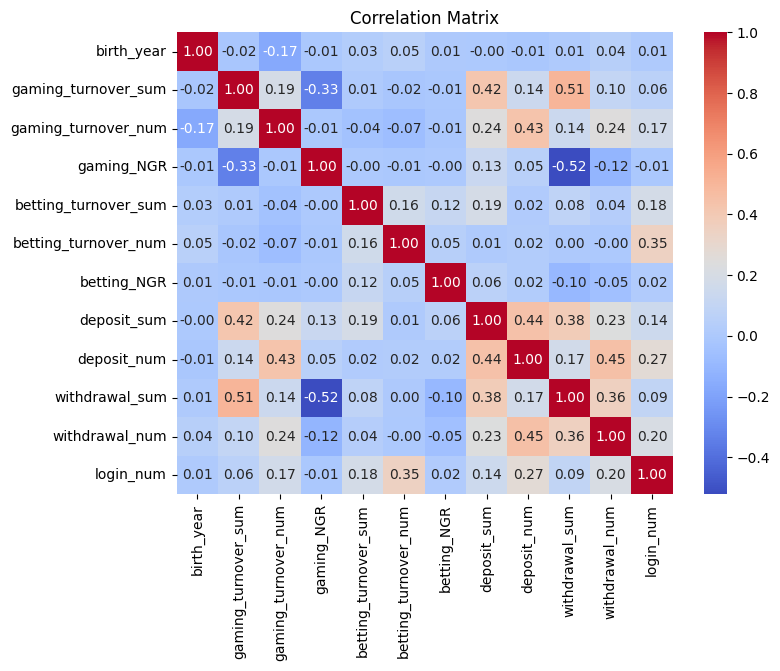

In [4]:
#Correlation Matrix
data['date'] = pd.to_datetime(data['date'])
df_sample = data.drop(['player_key', 'date'], axis=1)
correlation_matrix = df_sample.corr()
print("Correlation Matrix (Pandas):\n", correlation_matrix)


plt.figure(figsize=(8, 6))  # Adjust figure size as needed
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f") #For pandas correlation matrix
#sns.heatmap(correlation_matrix_np, annot=True, cmap='coolwarm', fmt=".2f") #For numpy correlation matrix
plt.title('Correlation Matrix')
plt.show()

Positive Correlations
1. gaming_turnover_sum and withdrawal_sum (0.51):
    Players who have higher gaming turnover tend to have higher withdrawal sums.
2. deposit_sum and gaming_turnover_sum (0.42):
    Players who deposit more tend to have higher gaming turnover sums.
3. deposit_num and gaming_turnover_num (0.430):
    Players who deposit more frequently tend to have a higher number of gaming turnovers.
4. withdrawal_num and deposit_num (0.45):
    Players who withdraw more frequently also tend to deposit more frequently.
5. login_num and betting_turnover_num (0.35):
    Players who log in more frequently tend to have a higher number of betting turnover

Negative Correlations
1. gaming_NGR and withdrawal_sum (-0.52):
    Players with higher gaming net gaming revenue (NGR) tend to have lower withdrawal sums.
3. birth_year and gaming_turnover_num (-0.17):
    Younger players (higher birth year) tend to have a lower number of gaming turnovers.

Other  Correlations
1. gaming_turnover_sum and gaming_turnover_num (0.19):
    Players with higher gaming turnover sums tend to have a higher number of gaming turnovers.
2. deposit_sum and withdrawal_sum (0.38):
    Players who deposit more tend to withdraw more.
3. login_num and deposit_num (0.27):
    Players who log in more frequently tend to deposit more frequently.

In [9]:
# Logging all the columns along with total_turnover, active and inactive_days
data = pd.read_csv('data.csv')
data['date'] = pd.to_datetime(data['date'])
# 1. Sort by player and date (ESSENTIAL)
data = data.sort_values(['player_key', 'date'])

# 2. Calculate days since last activity (Corrected for daily aggregations)
data['total_turnover'] = data['gaming_turnover_sum'] + data['betting_turnover_sum']  # Combine turnover

# 3. Create a 'active' column: 1 if active (any turnover), 0 if inactive
data['active'] = np.where(data['total_turnover'] > 0, 1, 0)


data['inactive_days'] = 0.0  # Initialize as float to handle NaNs

enable_logging = False  # Set to True to print relevant columns for all players
for player_key, group in data.groupby('player_key'):
    last_active_date = None
    for i in range(len(group)):
        if group['active'].iloc[i] == 1:
            last_active_date = group['date'].iloc[i]
            data.loc[group.index[i], 'inactive_days'] = 0  # Reset inactive days
        elif last_active_date is not None:  # Only calculate if there was previous activity
            inactive_days = (group['date'].iloc[i] - last_active_date).days
            data.loc[group.index[i], 'inactive_days'] = inactive_days

# 4. Print relevant columns for all players
if enable_logging:
    for player_gkey, group in data.groupby('player_key'):
        print(group[['date','betting_NGR','gaming_NGR','gaming_turnover_sum','betting_turnover_sum','total_turnover', 'active', 'inactive_days']])  # Print relevant columns
        print("-" * 20)

Minimum date: 2020-01-01 00:00:00
Maximum date: 2023-06-30 00:00:00
Plotting gaming_turnover_sum for 10 players


C:\Users\swede\AppData\Local\Temp\ipykernel_12644\3283182127.py:36: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = cm.get_cmap('tab10', len(players))  # Get a colormap with a unique color for each player


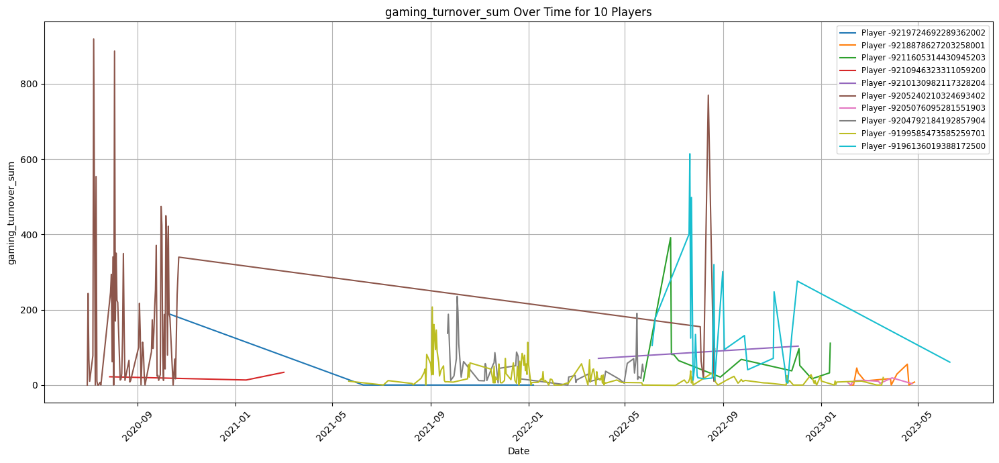

Plotting gaming_turnover_num for 10 players


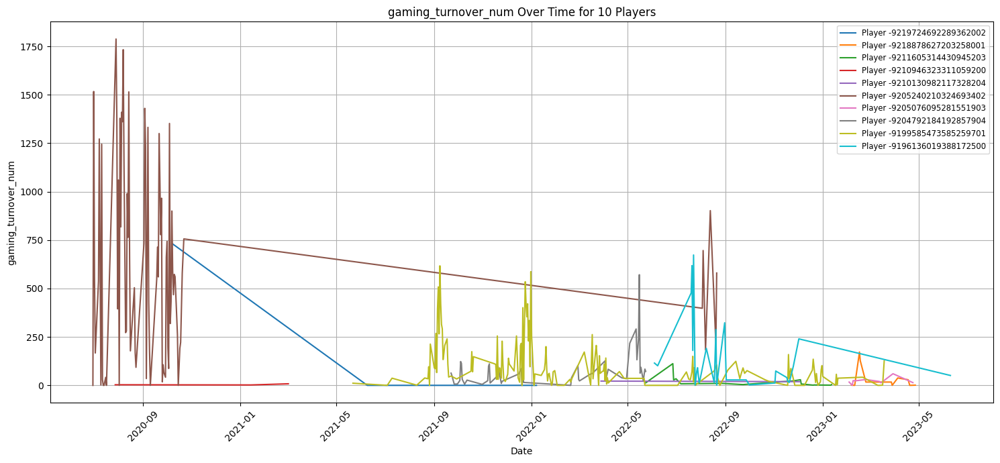

Plotting gaming_NGR for 10 players


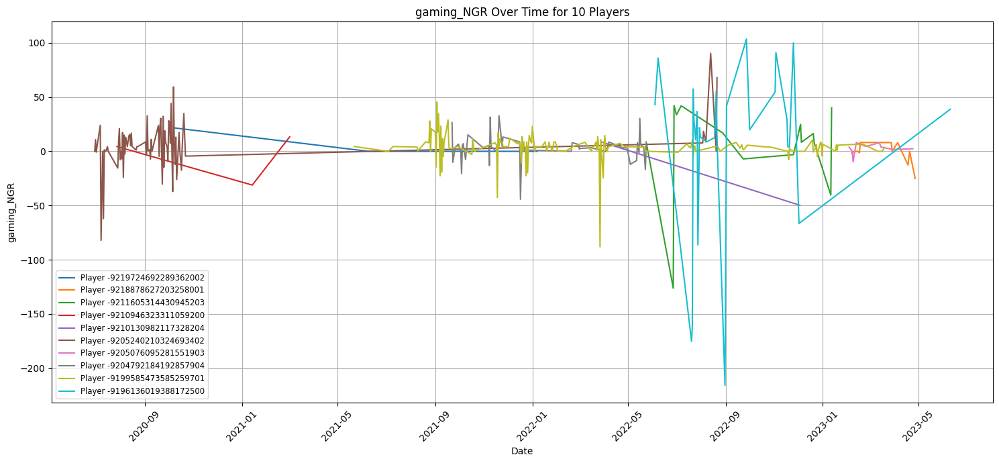

Plotting betting_turnover_sum for 10 players


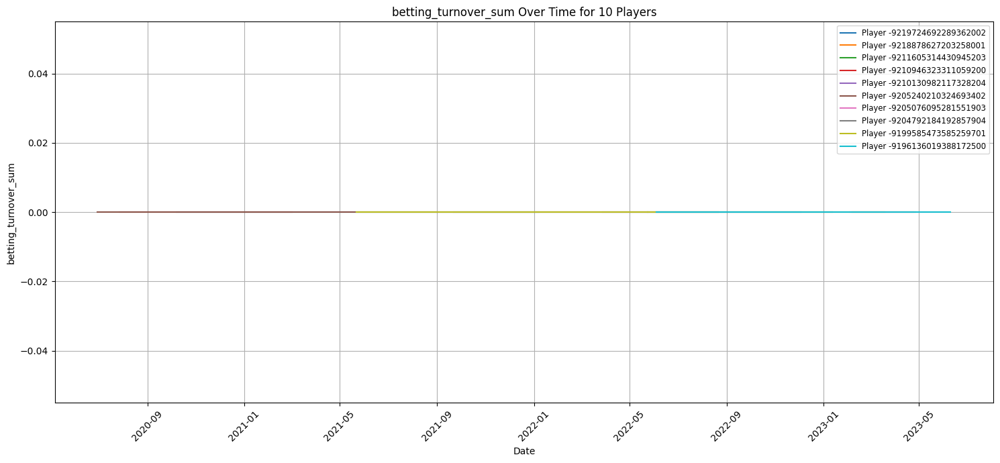

Plotting betting_turnover_num for 10 players


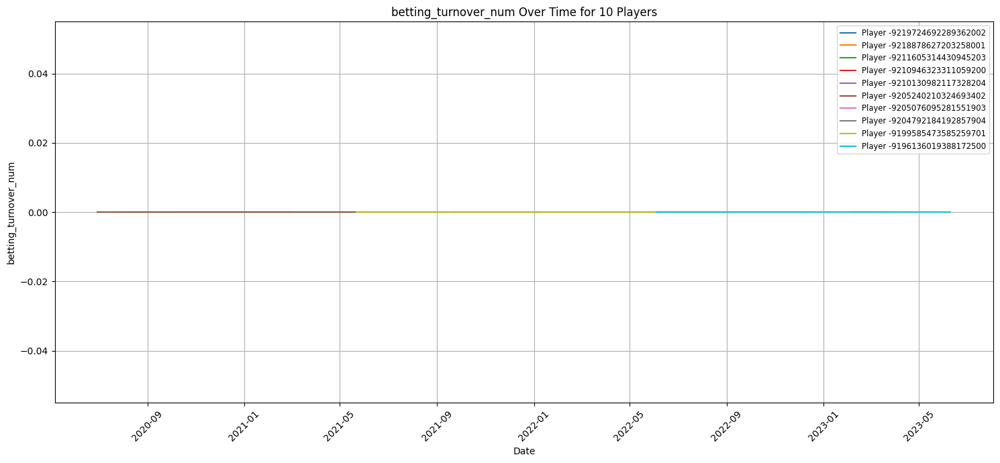

Plotting betting_NGR for 10 players


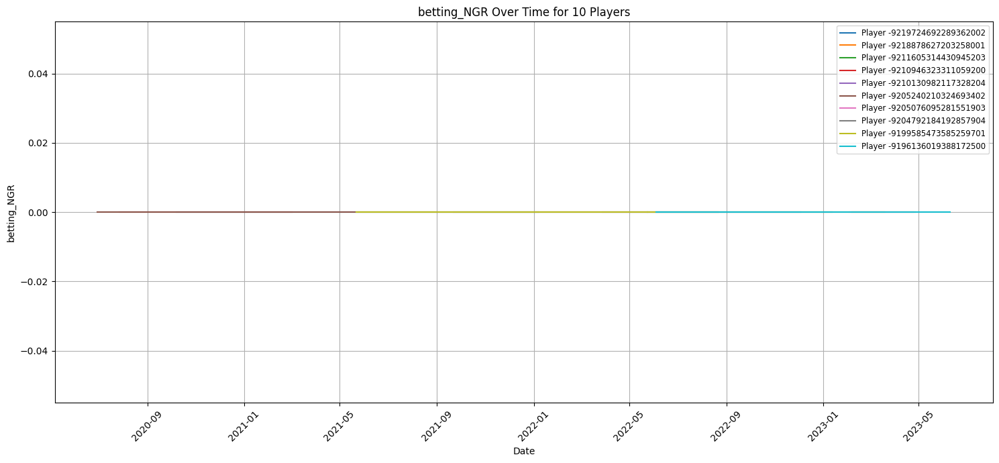

Plotting deposit_sum for 10 players


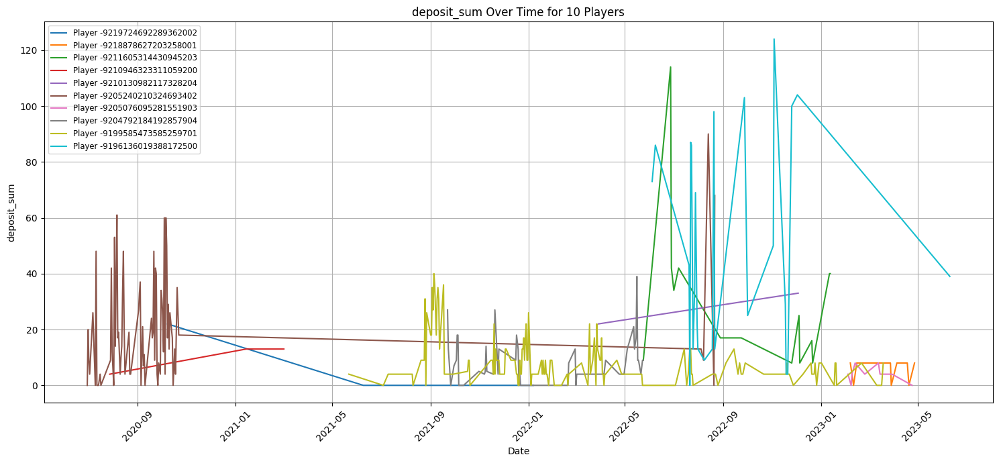

Plotting deposit_num for 10 players


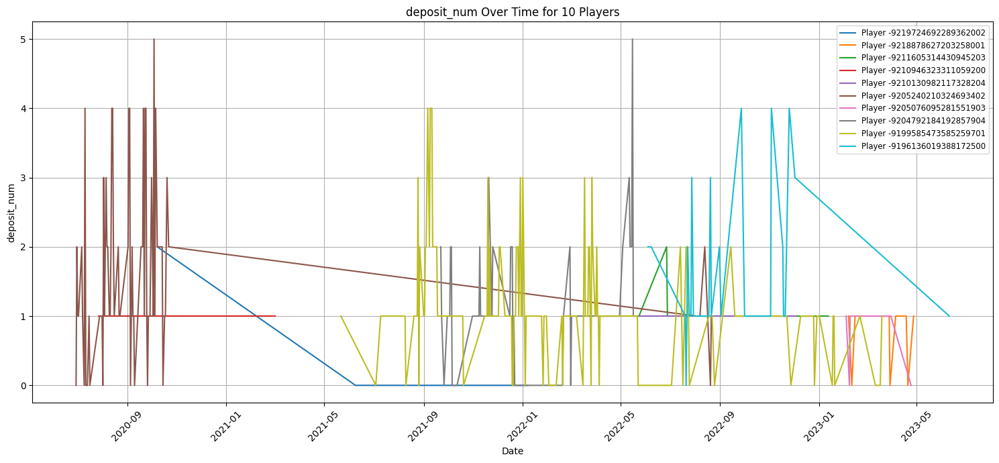

Plotting withdrawal_sum for 10 players


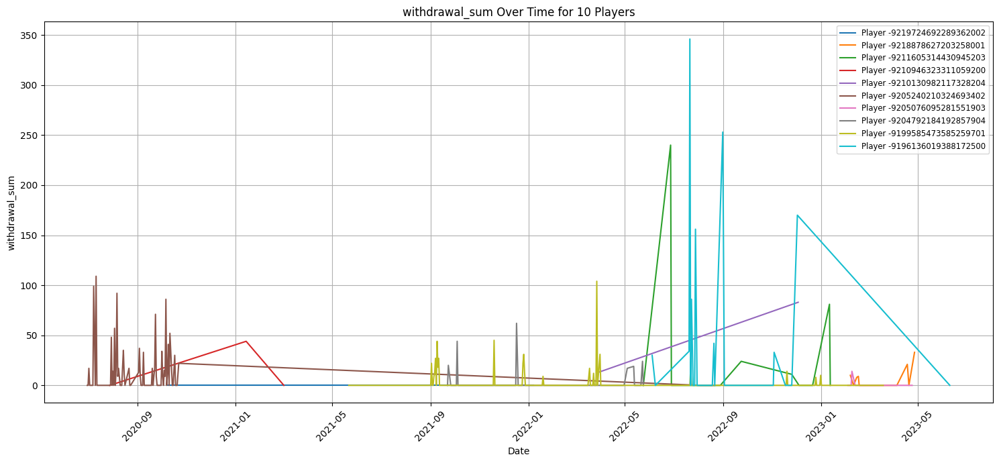

Plotting withdrawal_num for 10 players


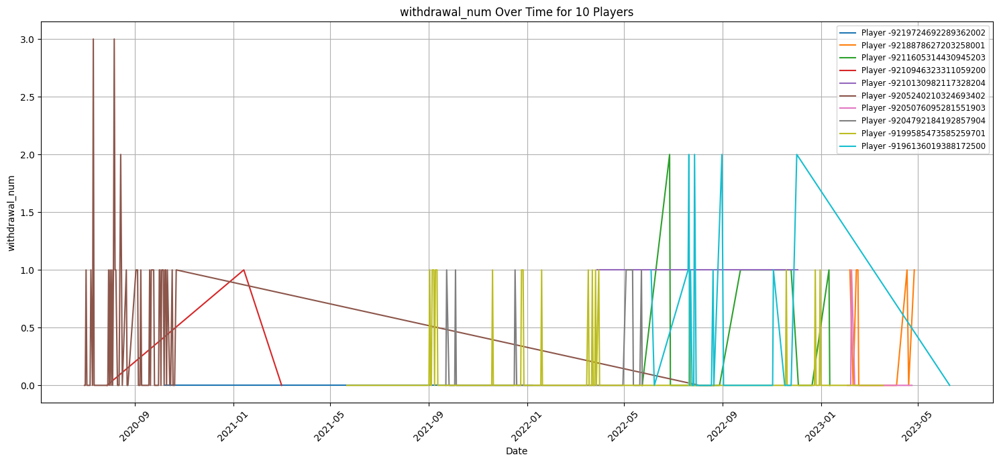

Plotting login_num for 10 players


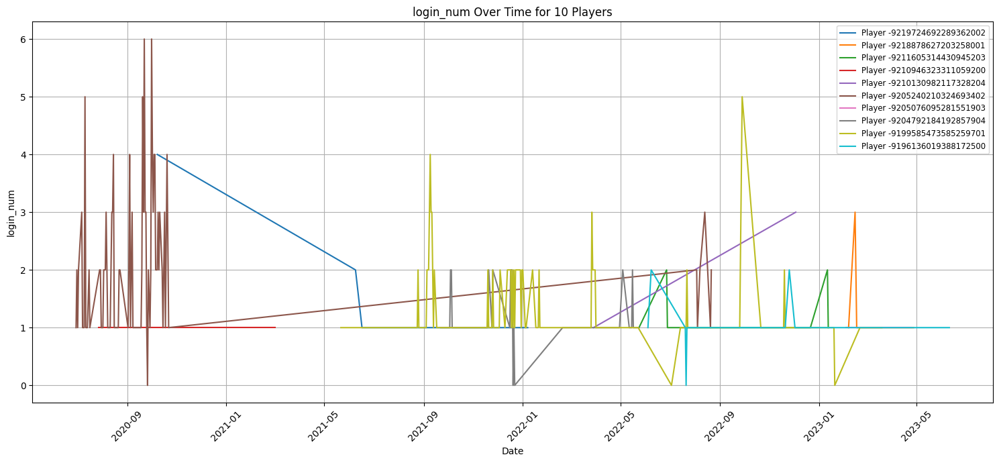

Plotting total_turnover for 10 players


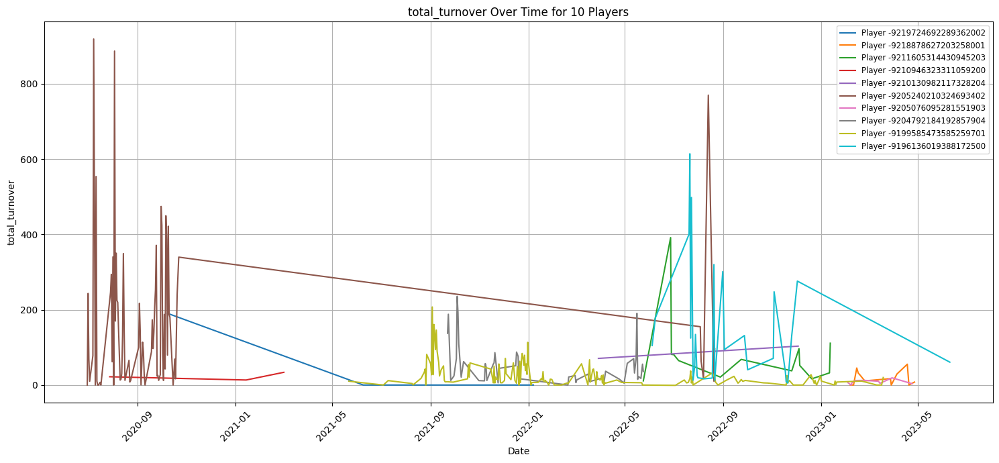

Plotting active for 10 players


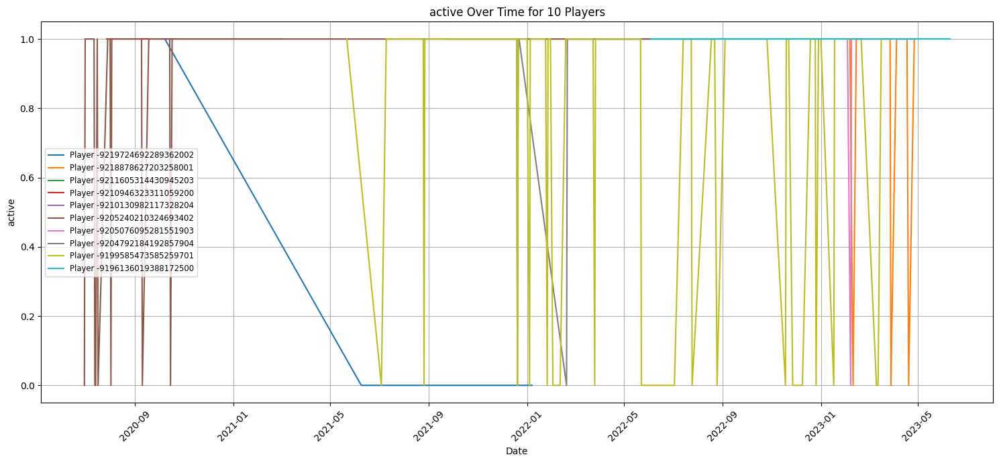

Plotting inactive_days for 10 players


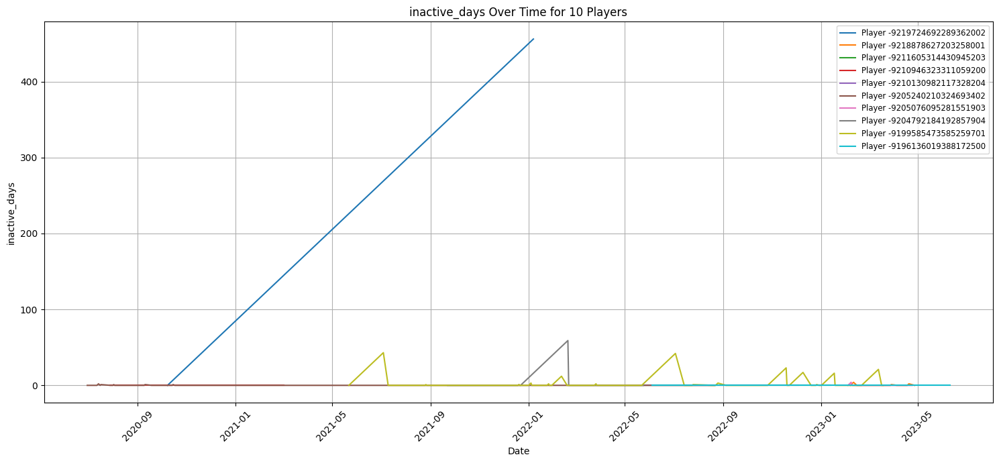

In [18]:
# Plot each feature over time for a few players
min_date = data['date'].min()
max_date = data['date'].max()

# Print the results
print(f"Minimum date: {min_date}")
print(f"Maximum date: {max_date}")
	
no_of_players = 10  # Number of players to plot
# 1. Select a few players (no_of_players)
sample_players = data['player_key'].unique()[:no_of_players]  # Get the first no_of_players unique player keys

# 2. Filter the data for these players
sample_data = data[data['player_key'].isin(sample_players)]

# 3. Set 'date' as the index for time series plotting
#sample_data = sample_data.set_index('date')

# 4. Define the columns to plot (excluding player_key, birth_year, and age)
columns_to_plot = [col for col in sample_data.columns if col not in [ 'date', 'player_key', 'birth_year', 'age']]

# 5. Create and display the plots

def plot_all_players_same_plot(df: pd.DataFrame, column_to_plot: str, no_of_players: int = 10):
    """
    Plots all players on the same plot for a given column, with different line styles for continuous, discontinuous, and non-continuous data.
    
    Args:
        df (DataFrame): The preprocessed DataFrame.
        column_to_plot (str): The name of the column to plot.
        number_inactive_days (int): The threshold in days to determine discontinuity (default is 30 days).
        no_of_players (int): The number of players to plot (default is 10).
    """
    plt.figure(figsize=(15, 7))  # Adjust figure size as needed

    players = df['player_key'].unique()[:no_of_players]
    colors = cm.get_cmap('tab10', len(players))  # Get a colormap with a unique color for each player

    for idx, player in enumerate(players):
        player_data = df[df['player_key'] == player].sort_values(by='date').reset_index(drop=True)
        if not player_data.empty:  # Check if player has data for the column
            plt.plot(player_data['date'], player_data[column_to_plot], linestyle='-', color=colors(idx), label=f"Player {player}")
        

    plt.title(f"{column_to_plot} Over Time for {no_of_players} Players")
    plt.xlabel("Date")
    plt.ylabel(column_to_plot)
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.legend(loc='best', fontsize='small')  # Adjust fontsize as needed
    plt.tight_layout()
    plt.show()
for col in columns_to_plot:
    print(f"Plotting {col} for {no_of_players} players")
    plot_all_players_same_plot(sample_data, col)


Minimum  date is 1 jan 2020 and maximum date is 30 june 2023

Lets analayze the first 10 players input features in time

1. Significant portion of players exhibit limited engagement with the platform,  churning after a brief period of activity. While some players  return after their absence from the platform creates gaps in our data. Truth is that 
everone churns

2. Accurately determining churn behavior relies primarily on finding data  for player activity before and after observed periods of engagement. In absence of this data we assume that engagement features 
correate with churning for example the players are more likely to churn if the withdrawal sum is high or if number of logins tend to decrease.





C:\Users\swede\AppData\Local\Temp\ipykernel_12644\3283182127.py:36: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = cm.get_cmap('tab10', len(players))  # Get a colormap with a unique color for each player


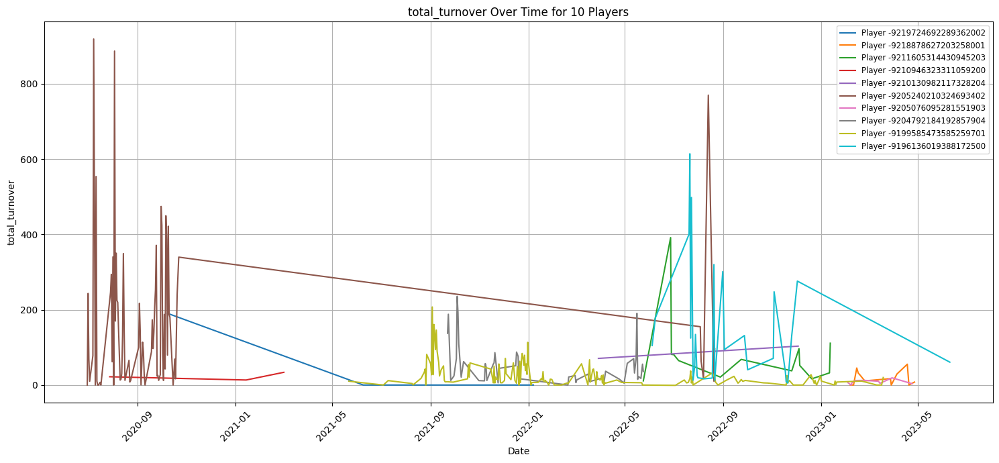

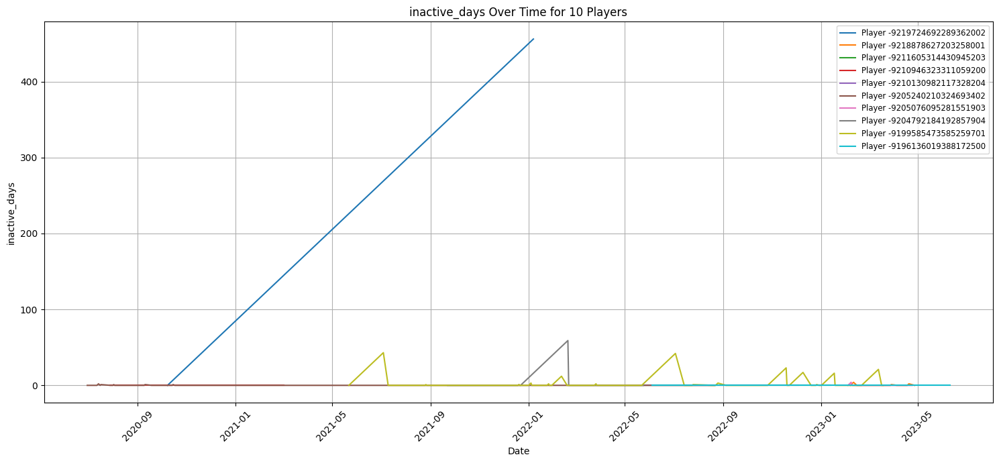

In [20]:
plot_all_players_same_plot(sample_data, "total_turnover")
plot_all_players_same_plot(sample_data, "inactive_days")

There are two  different approaches to define churn customers. Churning can be modelled as pure classification problem. If total turnover from gaming and betting is zero for a given time interval; we mark that sample as churned.

In both this approaches, the first transaction after a longer period of betting inactivity is classified as churned if there was no betting for the given transaction.



Transactional Context

Mark a customer as churned if they have not placed a bet for a chosen period (30 days) at the transaction level.
This approach leverages daily or more granular data and flags inactivity directly in the raw transaction logs. Since the data is highly imbalanced, we apply SMOTE to undersample the non churned featuers and oversample the chruned features. 



Resampled Time-Series Contex

Aggregate player activity into weekly (or monthly) time windows.
Mark churn if the customer has not bet for 30 days when examining these weekly timewindow.
This smooths out daily fluctuations and provides a higher-level view of engagement. Idea is to correlate time series of aggregate features during low betting activity to Churning.








# Transactional Context

In [ ]:


No bets (gaming or sports) placed in the last 30 days

# Calculate daily total turnover
data['total_turnover'] = data['gaming_turnover_sum'] + data['betting_turnover_sum']

# As Date and inactive_days information are not included in our input features for modelling, there is no chance of data/target leakage.

In [2]:
def add_new_features(df):
    """
    Adds new features to enhance churn prediction:

    1. Bet frequency ratio: total bet count / total login count.
    2. Periodic net deposit difference
    3. Turnover-volatility ratio: standard deviation of turnover / mean turnover.
    """
    # Total turnover
    df['total_turnover'] = df['gaming_turnover_sum'] + df['betting_turnover_sum']

    # Bet frequency ratio: bet count / login count
    # Replace zero login counts to avoid inf
    df['login_num'] = df['login_num'].replace(0, np.nan)
    df['bet_frequency_ratio'] = (df['gaming_turnover_num'] + df['betting_turnover_num']) / df['login_num']
    df['bet_frequency_ratio'] = df['bet_frequency_ratio'].fillna(0)

    # Turnover volatility ratio (if you have multiple daily records per player):
    # For demonstration, use stdev of gaming turnover num + betting turnover num
    df['turnover_count_std'] = (df[['gaming_turnover_num', 'betting_turnover_num']]
                                 .std(axis=1))
    df['turnover_count_mean'] = (df[['gaming_turnover_num', 'betting_turnover_num']]
                                  .mean(axis=1))
    df['turnover_volatility_ratio'] = df.apply(
        lambda row: row['turnover_count_std'] / row['turnover_count_mean']
        if row['turnover_count_mean'] != 0 else 0, axis=1
    )

    # Periodic net deposit difference
    df['net_deposits'] = df['deposit_sum'] - df['withdrawal_sum']
    return df
 

In [3]:
# Define churn target based on inactivity
def define_churn(data, inactivity_threshold=30):
    """
    data: DataFrame with columns
    inactivity_threshold: number of days for inactivity checks
    """
    # Ensure data is sorted for group-based rolling windows
    data = data.sort_values(by=['player_key', 'date']).copy()

    # Calculate daily net deposits (deposits minus withdrawals)
    data['net_deposits'] = data['deposit_sum'] - data['withdrawal_sum']
    
    # Calculate daily total turnover
    data['total_turnover'] = data['gaming_turnover_sum'] + data['betting_turnover_sum']

    # Rolling sums need a fixed frequency, so group by player and use rolling on sorted dates.
    def rolling_features(group):
        group = group.set_index('date')
        # n-day rolling sums for bets
        group['bets_nd'] = group['total_turnover'].rolling(f'{inactivity_threshold}D').sum()
        return group.reset_index()

    data = data.groupby('player_key', group_keys=False).apply(rolling_features)

    # Now define churn flags for each criterion:
    # 1) No bets placed in the last n days
    data['flag_no_bets'] = data['bets_nd'] == 0
    # 2) Identify each player's earliest date using a ranking approach
    data['is_first_date'] = data.groupby('player_key')['date'].rank(method='first') == 1
    # 3) Force the first date for each player to be False for 'flag_no_bets'
    data.loc[data['is_first_date'], 'flag_no_bets'] = False
    data['churn'] = data['flag_no_bets']       
    return data

In [11]:
data = pd.read_csv('data.csv')
enable_new_features = False
data['date'] = pd.to_datetime(data['date'])
# 1. Sort by player and date (ESSENTIAL)
data = data.sort_values(['player_key', 'date'])

# 2. Calculate days since last activity (Corrected for daily aggregations)
data['total_turnover'] = data['gaming_turnover_sum'] + data['betting_turnover_sum']  # Combine turnover

# 3. Create a 'active' column: 1 if active (any turnover), 0 if inactive
data['active'] = np.where(data['total_turnover'] > 0, 1, 0)


data['inactive_days'] = 0.0  # Initialize as float to handle NaNs

for player_key, group in data.groupby('player_key'):
    last_active_date = None
    for i in range(len(group)):
        if group['active'].iloc[i] == 1:
            last_active_date = group['date'].iloc[i]
            data.loc[group.index[i], 'inactive_days'] = 0  # Reset inactive days
        elif last_active_date is not None:  # Only calculate if there was previous activity
            inactive_days = (group['date'].iloc[i] - last_active_date).days
            data.loc[group.index[i], 'inactive_days'] = inactive_days

# 4. Calculate churn with a 7-day lookback if there is no betting activity
data = define_churn(data, inactivity_threshold=30)
for player_key, group in data.groupby('player_key'):
    print(f"Player: {player_key}")
    print(group[['date','net_deposits', 'total_turnover', 'active', 'inactive_days', 'churn']])  # Print relevant columns
    print("-" * 20)

/tmp/ipykernel_34164/19372790.py:22: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  data = data.groupby('player_key', group_keys=False).apply(rolling_features)


Player: -9219724692289362002
        date  net_deposits  total_turnover  active  inactive_days  churn
0 2020-10-08            22          190.39       1            0.0  False
1 2021-06-09             0            0.00       0          244.0   True
2 2021-06-17             0            0.00       0          252.0   True
3 2022-01-07             0            0.00       0          456.0   True
--------------------
Player: -9218878627203258001
         date  net_deposits  total_turnover  active  inactive_days  churn
0  2023-02-06            -2            0.20       1            0.0  False
1  2023-02-10             0            0.00       0            4.0  False
2  2023-02-14             0           45.23       1            0.0  False
3  2023-02-16            -1           30.93       1            0.0  False
4  2023-02-17             8           29.24       1            0.0  False
5  2023-02-24             8           11.02       1            0.0  False
6  2023-03-28             8           

Player: -9219724692289362002
        date  net_deposits  total_turnover  active  inactive_days  churn
0 2020-10-08            22          190.39       1            0.0  False
1 2021-06-09             0            0.00       0          244.0   True
2 2021-06-17             0            0.00       0          252.0   True
3 2022-01-07             0            0.00       0          456.0   True

Transaction 2-4 have inactive days in 244-456 hence they are marked churned

In [12]:


if enable_new_features:
    features = [
    'birth_year','gaming_turnover_sum', 'gaming_turnover_num', 'gaming_NGR',
    'betting_turnover_sum', 'betting_turnover_num', 'betting_NGR',
    'deposit_sum', 'deposit_num', 'withdrawal_sum', 'withdrawal_num', 'login_num'
    ,'total_turnover','bet_frequency_ratio','turnover_count_std','turnover_count_mean','turnover_volatility_ratio','net_deposits'
]
else:
    features = [
    'birth_year',
        'gaming_turnover_sum', 'gaming_turnover_num', 'gaming_NGR',
        'betting_turnover_sum', 'betting_turnover_num', 'betting_NGR',
        'deposit_sum', 'deposit_num', 'withdrawal_sum', 'withdrawal_num', 'login_num'
    ]





In [13]:

# Add new features
# We have added features such as bet_frequency_ratio,turnover_count_std,turnover_count_mean,turnover_volatility_ratio,net_deposits
if enable_new_features:
    data = add_new_features(data)

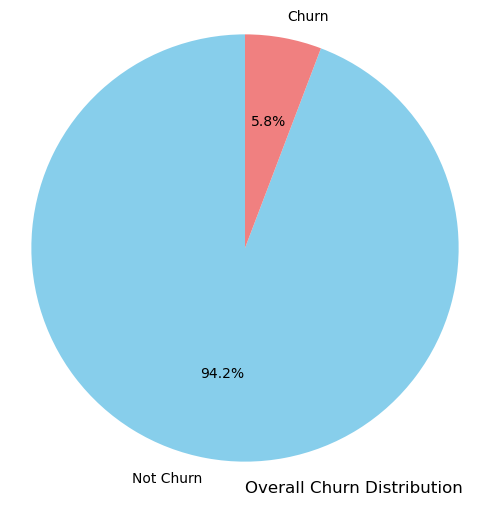

In [9]:

def plot_churn_pie(df, churn_col='churn'):
    """Plots the churn distribution as a pie chart."""

    churn_counts = df[churn_col].value_counts()

    if not churn_counts.empty:  # Check for empty data
        labels = ['Not Churn', 'Churn']
        colors = ['skyblue', 'lightcoral']  # Choose your colors
        # or use seaborn color palette:
        #colors = sns.color_palette('pastel')[0:2]
        plt.figure(figsize=(5, 5))
        plt.pie(churn_counts, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90)
         # Place title BELOW the chart
        plt.figtext(0.5, 0.01, "Overall Churn Distribution", ha="left", fontsize=12) # Adjust vertical position (0.01) and fontsize as needed # Clear title
        plt.axis('equal')  # Equal aspect ratio for a circular pie
        plt.tight_layout()
        plt.show()
    else:
        print("No churn data available.")

# Example usage (assuming your DataFrame is named 'data' and the churn column is 'churn'):
plot_churn_pie(data, churn_col='churn')

Churn datasets often have a significantly larger number of non-churned customers than churned customers.  Training a model on imbalanced data can lead to a model that is biased towards the non-churned  and performs poorly on the churned, which is usually the class of interest.

In [18]:
## Undersampling the Majority Class  and Oversampling the Minority Class:
X = data[features]
y = data['churn']

if enable_new_features:
    # Strategy 1: Imputation (replace NaNs with a value)
    imputer = SimpleImputer(strategy='mean')  # Or 'median', 'most_frequent', etc.
    X_imputed = imputer.fit_transform(X)  # Fit and transform X
    X = pd.DataFrame(X_imputed, columns=X.columns, index=X.index) # Convert back to dataframe
# Oversample with SMOTE
smote = SMOTE(random_state=42, sampling_strategy=0.5) # Example: Oversample to 50% of majority class
X_over, y_over = smote.fit_resample(X, y)


# Undersample
rus = RandomUnderSampler(random_state=42, sampling_strategy='majority') # Example: Undersample majority to be equal to minority

X_resampled, y_resampled = rus.fit_resample(X_over, y_over)


X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.3, random_state=42)





In [19]:
# Standardize the features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Train the model
model = xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss')
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

# Save the model
model.save_model('churn_model.json')

/home/dk2048/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [00:07:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[[52534  6424]
 [   94 58845]]
              precision    recall  f1-score   support

       False       1.00      0.89      0.94     58958
        True       0.90      1.00      0.95     58939

    accuracy                           0.94    117897
   macro avg       0.95      0.94      0.94    117897
weighted avg       0.95      0.94      0.94    117897



Transactional Context  Evaluation Report(on 7 days betting inactivity)




        False   True
False [[52632  6326]
True  [  133 58806]]

F1  Score (Churn=False) = 0.94
F1  Scrore(Churn=True) = 0.95
              precision    recall  f1-score   support

       False       1.00      0.89      0.94     58958
        True       0.90      1.00      0.95     58939

    accuracy                           0.95    117897
   macro avg       0.95      0.95      0.95    117897
weighted avg       0.95      0.95      0.95    117897

# Limitation
SMOTE resamping creates synthetic data points and relies heavily on feature scaling so SMOTE sampling increases predictive performance at the expense of interpretability.

Temporal affects are not modelled in trasanctional features so inoder to make the transaction feature work better, there should be few data points(one immediate after player went inactive and one immediate before it reactivated) which is why SMOTE synthetic data points lead to very high F1 score.

 

# Time series context


In [25]:
# Resampled Time-Series Contex
def create_time_series_data(df, time_window='W'):  # Default to weekly windows
    """Creates time-series aggregated data for each player."""

    df = df.sort_values(['player_key', 'date']).copy()  # Ensure proper order
    df['date'] = pd.to_datetime(df['date']) # Convert to datetime objects.

    df = df.set_index('date') # Set date as index to use resample function.

    time_series_data = []
    for player_key, group in df.groupby('player_key'):
        resampled_group = group.resample(time_window).agg({
            'total_turnover': 'sum',
            'gaming_turnover_sum': 'sum',
            'betting_turnover_sum': 'sum',
            'deposit_sum': 'sum',
            'withdrawal_sum': 'sum',
            'login_num': 'sum',
            'active': 'sum', # Number of active days in time window.
            'inactive_days': 'max', # Max inactive days in time window.
            'churn': 'max', # Churn status for the time window.
            'betting_NGR': 'sum',
            'gaming_NGR': 'sum',
            'net_deposits': 'sum'
        }).fillna(0) # Fill NaN with 0.

        resampled_group['player_key'] = player_key
        time_series_data.append(resampled_group.reset_index()) # Add index as a column.

    final_df = pd.concat(time_series_data)  
    return final_df


In [53]:
data = pd.read_csv('data.csv')
enable_new_features = True
last_bet_days = 28
data['date'] = pd.to_datetime(data['date'])
# 1. Sort by player and date 
data = data.sort_values(['player_key', 'date'])

# 2. Calculate days since last activity 
data['total_turnover'] = data['gaming_turnover_sum'] + data['betting_turnover_sum']  # Combine turnover

# 3. Create a 'active' column: 1 if active (any turnover), 0 if inactive
data['active'] = np.where(data['total_turnover'] > 0, 1, 0)


data['inactive_days'] = 0.0  # Initialize as float to handle NaNs

for player_key, group in data.groupby('player_key'):
    last_active_date = None
    for i in range(len(group)):
        if group['active'].iloc[i] == 1:
            last_active_date = group['date'].iloc[i]
            data.loc[group.index[i], 'inactive_days'] = 0  # Reset inactive days
        elif last_active_date is not None:  # Only calculate if there was previous activity
            inactive_days = (group['date'].iloc[i] - last_active_date).days
            data.loc[group.index[i], 'inactive_days'] = inactive_days

# 4. Calculate churn with a 7-day lookback if there is no betting activity
data = define_churn(data, inactivity_threshold=last_bet_days)
for player_key, group in data.groupby('player_key'):
    print(f"Player: {player_key}")
    print(group[['date','net_deposits', 'total_turnover', 'active', 'inactive_days', 'churn']])  # Print relevant columns
    print("-" * 20)
# Add new features
if enable_new_features:
    data = add_new_features(data)    

/tmp/ipykernel_34164/19372790.py:22: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  data = data.groupby('player_key', group_keys=False).apply(rolling_features)


Player: -9219724692289362002
        date  net_deposits  total_turnover  active  inactive_days  churn
0 2020-10-08            22          190.39       1            0.0  False
1 2021-06-09             0            0.00       0          244.0   True
2 2021-06-17             0            0.00       0          252.0   True
3 2022-01-07             0            0.00       0          456.0   True
--------------------
Player: -9218878627203258001
         date  net_deposits  total_turnover  active  inactive_days  churn
0  2023-02-06            -2            0.20       1            0.0  False
1  2023-02-10             0            0.00       0            4.0  False
2  2023-02-14             0           45.23       1            0.0  False
3  2023-02-16            -1           30.93       1            0.0  False
4  2023-02-17             8           29.24       1            0.0  False
5  2023-02-24             8           11.02       1            0.0  False
6  2023-03-28             8           

In [66]:
# Feature Engineering 
# We have added rolling_mean_turnover_4w and turnover_change features to the time series data.
time_series_df = create_time_series_data(data, time_window='W') # 'D' for daily, 'W' for weekly, 'M' for monthly.
time_series_df['rolling_mean_turnover_4w'] = time_series_df.groupby('player_key')['total_turnover'].rolling(window=4).mean().reset_index(level=0, drop=True).fillna(0)
time_series_df['turnover_change'] = time_series_df.groupby('player_key')['total_turnover'].pct_change().fillna(0) # Fill NaN with 0.
time_series_df = time_series_df.fillna(0) # Fill NaN with 0 after feature engineering.

In [55]:
# Feature Selection
if enable_new_features:
    features = [
        'total_turnover',
        'gaming_turnover_sum',
        'betting_turnover_sum',
        'deposit_sum',
        'withdrawal_sum',
        'login_num',
        'rolling_mean_turnover_4w',
        'turnover_change',
        'betting_NGR',
        'gaming_NGR',
        'net_deposits'
    ]
else:
    features = [
    'total_turnover',
    'gaming_turnover_sum',
    'betting_turnover_sum',
    'deposit_sum',
    'withdrawal_sum',
    'login_num',
    'rolling_mean_turnover_4w',
    'turnover_change'
]    

In [68]:
X = time_series_df[features]
y = time_series_df['churn']

# 1. Replace ±∞ with NaN
X = X.replace([np.inf, -np.inf], np.nan)

# 2. Optionally fill NaN (e.g., with zero) or drop them
X = X.fillna(0)

# 3. (Optional) Clip extreme outliers if necessary
X = X.clip(lower=-1e5, upper=1e5)


scaler = RobustScaler()
X_scaled = scaler.fit_transform(X)
#X_scaled = X
# Time-based Data Splitting (Crucial!)
train_cutoff = time_series_df['date'].quantile(0.7)  # 70% for training
X_train = X_scaled[time_series_df['date'] <= train_cutoff]
y_train = y[time_series_df['date'] <= train_cutoff]
X_test = X_scaled[time_series_df['date'] > train_cutoff]
y_test = y[time_series_df['date'] > train_cutoff]

In [57]:
enable_new_features

True

In [74]:

# Model Training
#model = GradientBoostingClassifier(random_state=42)
model = xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss')
model.fit(X_train, y_train)

# Model Evaluation
y_pred = model.predict(X_test)
y_probs = model.predict_proba(X_test)[:, 1]
auc_roc = roc_auc_score(y_test, y_probs)
print("AUC-ROC:", auc_roc)

# Evaluate the model
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

/home/dk2048/anaconda3/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [00:54:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


AUC-ROC: 0.9956511782022617
[[183039    437]
 [   481   2658]]
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    183476
         1.0       0.86      0.85      0.85      3139

    accuracy                           1.00    186615
   macro avg       0.93      0.92      0.93    186615
weighted avg       1.00      1.00      1.00    186615



Resampled Time-Series Contex  Evaluation Report



        False   True
False [[183039  437]
True  [  481 2658]]

F1  Score (Churn=False) = 1.00
F1  Scroe(Churn=True) = 0.85

Sensitivity(Recall)= 0.85
Positive predictive value(Precision) = 0.86

AUC-ROC: 0.9956511782022617
[[183039    437]
 [   481   2658]]
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    183476
         1.0       0.86      0.85      0.85      3139

    accuracy                           1.00    186615
   macro avg       0.93      0.92      0.93    186615
weighted avg       1.00      1.00      1.00    186615

 Limitation

In the above implementation, the target class is defined as churned if there is atleast one churn in timeseries window. The resampled time series behaves well with continous features as the number of logins, total_turnover, total_deposit are correlated but this approach  ends up misclassifying  all weekly interval values as churned giving more weightage to the past inactivity using input from the current input features.
 

Ideal Implementation
1. Truth is that everone churns at some time. So we need to reformulate this problem as to find when customer churns.
Can we define Churning as Regression problem. Define churning in days when the user would leave the platform.
Solve it with the  Survival analysis but there are two problems for labelling the data.
a. If we simply use the current tenure for customers who haven't churned, your model will be biased.
b. Completely excluding customers who haven't churned is also problematic

The standard approach is to solve it with Cox Proportional Hazards Model.


2. Data gap analysis 
We lack gaming & customer behavior specific features as we come to conclusion that 
some players are churning away without seeing any major change in the feature patterns.
for eg. Session time(time spent playing games/betting) is one of the most important features to measure customer engagement which is missing in csv.

